In [26]:
from skimage.restoration import inpaint
from skimage.segmentation import flood_fill
from skimage.morphology import disk
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
from pylab import rcParams
import scipy.ndimage as nd
from queue import Queue
import pandas as pd
import numpy as np
import cv2

In [27]:
_df = pd.read_csv("D:\Godis\Projects\SampleCoreAnalysisPresentation\data.csv")

In [76]:
from os import listdir
names = listdir("D:\Godis\Projects\SampleCoreAnalysisPresentation\cracksData")
ids = list(map(lambda x: x.split(".")[0], names))

df = _df[_df["PhotoType"] == "ДС"]
df = df[df["Id"].isin(ids)]

In [77]:
AREA_R_ABS = 0.5       # sm
AREA_HOLE_R_ABS = 0.35 # sm
INFL_AREA_R = 0.30     # sm
RESOLUTION = 20        # px/sm

CRACK_TR_KOEF = 0.65  # -
SRC_TR = 20           # value from [0; 256]
CRACK_TR = 60         # value from [0; 256]

AREA_R = int(AREA_R_ABS*RESOLUTION)            # px
AREA_HOLE_R = int(AREA_HOLE_R_ABS*RESOLUTION)  # px
INFL_AREA_R = int(INFL_AREA_R*RESOLUTION)      # px

WORK_DIR = "D:/Godis/Projects/SampleCoreAnalysisPresentation"



In [78]:
def scaleImg(img, absH, res):
    koef = (absH/img.size[1])*res
    # first - width, second - height
    return img.resize((int(img.size[0]*koef), int(img.size[1]*koef)))

In [79]:
def cropBorders(img, res):
    cropSM = 2
    cropPX = int(2*res)
    return img[:, cropPX:-cropPX]

In [80]:
def createCrackMask(gray):
    npFG = np.empty_like(gray)
    
    n = AREA_R
    m = AREA_HOLE_R
    weights = disk(n)
    middle = disk(m)
        
    # filter kernel
    weights[n-m:n+m+1,n-m:n+m+1] = np.logical_and(weights[n-m:n+m+1,n-m:n+m+1], np.logical_not(middle))
    weights = weights/np.sum(weights)
    
    # for each pixel find middle value in the local area
    midGray = nd.convolve(gray, weights, output=None, mode='reflect', cval=0.0, origin=0)
    
    # select all pixels, which are less, than alpha*(middle value) in local area
    # and which are less than tresh value
    mask = np.logical_and(gray < (CRACK_TR_KOEF*midGray), gray < CRACK_TR)
    mask = np.logical_or(mask, gray < SRC_TR)
    
    npFG[mask] = 127
    npFG[np.logical_not(mask)] = 0
    
    q = Queue()
    n = INFL_AREA_R
    area = disk(n)
    for i in range(npFG.shape[0]):
        for j in range(npFG.shape[1]):
            if (gray[i,j] < SRC_TR):
                q.put((i, j))
                
    while q.qsize() > 0:
        y, x = q.get()
        for i in range(-n,n+1):
            for j in range(-n,n+1):
                if (i+y < 0 or j+x < 0 or i+y >= npFG.shape[0] or j+x >= npFG.shape[1]):
                    continue
                if (area[i+n,j+n]==255):
                    continue
                if (npFG[y+i,x+j]==127):
                    npFG[y+i,x+j] = 255
                    q.put((y+i,x+j))
                    
    npFG[npFG == 127] = 0
    
    return npFG

In [81]:
def createBigCrackMask(cracksMask, crackSize):
    n = crackSize//2
    
    mask = np.copy(cracksMask)
    mask[mask==255] = 127
    
    seedsMask = nd.binary_erosion(cracksMask, structure=disk(n))
    
    seeds = np.argwhere(seedsMask>0)
    
    for seed in seeds:
        index = tuple(seed)
        if (mask[index] == 255):
            continue
        mask = flood_fill(mask, index, 255)
    mask[mask==127] = 0
    return mask

In [82]:
def createBigCrackZones(bigCracksMask, radius):
    vMask = np.any(bigCracksMask, axis=1)
    vMask = nd.binary_dilation(vMask, structure=np.ones(radius))
    
    zones = []
    i = 0
    while(i < vMask.shape[0]):
        if (vMask[i] == 0):
            i += 1
            continue
        start = i
        
        i += 1
        while(i < vMask.shape[0] and vMask[i] != 0):
            i += 1
        end = i
        zones.append((start, end))
        i += 1
    
    return zones

In [83]:
def selectZones(img, color, zones):
    
    img = img.convert("RGBA")
    
    overlay = Image.new('RGBA', img.size, (0, 0, 0)+(0,))
    draw = ImageDraw.Draw(overlay)
    
    for zone in zones:
        x0y0 = (0, zone[0])
        x1y1 = (img.size[0], zone[1])
            
        #print("{}, {}".format(x0y0, x1y1))
        
        draw.rectangle((x0y0, x1y1), fill=color)
    
    img = Image.alpha_composite(img, overlay)
    return img

In [84]:
def removeLittleCracks(img, mask, radius):
    return cv2.inpaint(img, np.uint8(mask), radius, cv2.INPAINT_TELEA)

1000000 image
Ruin: не разрушен
Size: 397x4067
Abs height: 100.0 sm
Scaled img size: 195x2000

1000004 image
Ruin: не разрушен
Size: 404x2229
Abs height: 55.00000000000001 sm
Scaled img size: 199x1100

1000010 image
Ruin: не разрушен
Size: 395x1872
Abs height: 46.0 sm
Scaled img size: 194x920

1000028 image
Ruin: не разрушен
Size: 398x1097
Abs height: 27.0 sm
Scaled img size: 195x540

1000040 image
Ruin: не разрушен
Size: 402x1438
Abs height: 34.999999999999964 sm
Scaled img size: 195x699

1000072 image
Ruin: не разрушен
Size: 398x1793
Abs height: 43.99999999999995 sm
Scaled img size: 195x879

1000148 image
Ruin: не разрушен
Size: 397x982
Abs height: 24.00000000000002 sm
Scaled img size: 194x480

1000184 image
Ruin: не разрушен
Size: 399x4088
Abs height: 100.0 sm
Scaled img size: 195x2000

1000212 image
Ruin: не разрушен
Size: 399x4093
Abs height: 100.0 sm
Scaled img size: 194x1999

1000348 image
Ruin: частично разрушен
Size: 644x2947
Abs height: 39.00000000000006 sm
Scaled img size: 1

D:\Programs\Anaconda\lib\site-packages\ipykernel_launcher.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



1001406 image
Ruin: не разрушен
Size: 348x1117
Abs height: 26.99999999999998 sm
Scaled img size: 168x539

1001414 image
Ruin: не разрушен
Size: 349x2762
Abs height: 65.99999999999997 sm
Scaled img size: 166x1319

1001450 image
Ruin: не разрушен
Size: 355x911
Abs height: 22.00000000000002 sm
Scaled img size: 171x440

1000000 image
Ruin: не разрушен
Size: 636x3582
Abs height: 48.0 sm
Scaled img size: 170x959

1000004 image
Ruin: не разрушен
Size: 628x7434
Abs height: 100.0 sm
Scaled img size: 168x1999

1000010 image
Ruin: не разрушен
Size: 612x6437
Abs height: 87.00000000000001 sm
Scaled img size: 165x1740

1000028 image
Ruin: не разрушен
Size: 637x7502
Abs height: 100.0 sm
Scaled img size: 169x1999

1000040 image
Ruin: не разрушен
Size: 649x447
Abs height: 6.00000000000005 sm
Scaled img size: 174x120

1000072 image
Ruin: не разрушен
Size: 641x1055
Abs height: 13.99999999999988 sm
Scaled img size: 170x279

1000148 image
Ruin: не разрушен
Size: 633x7429
Abs height: 100.0 sm
Scaled img si

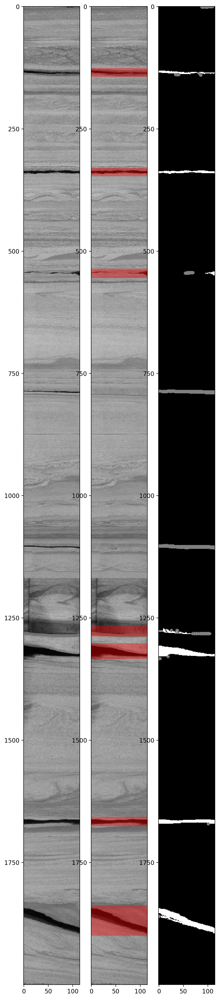

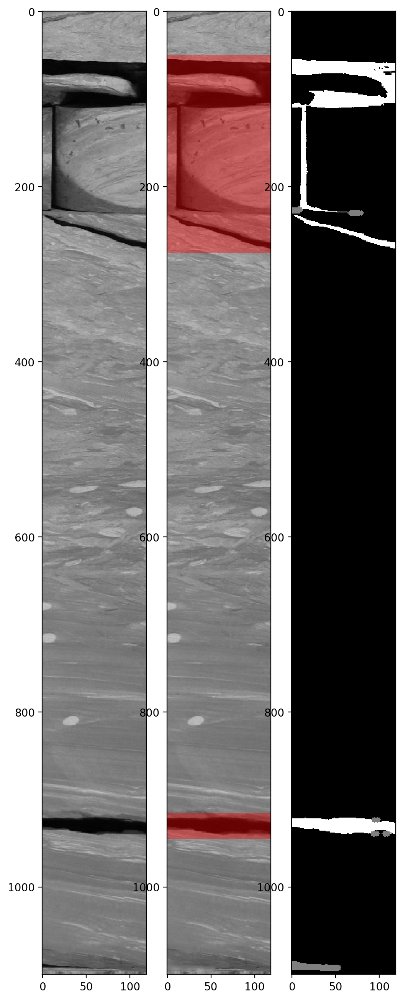

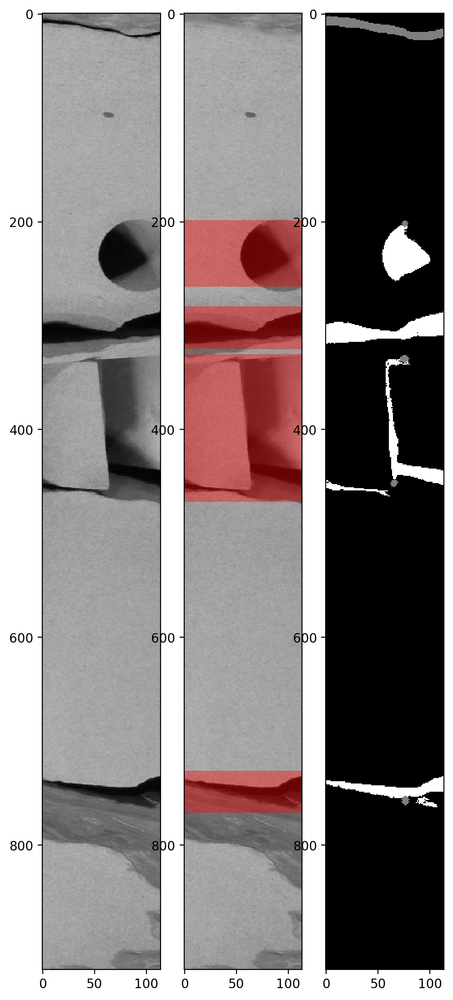

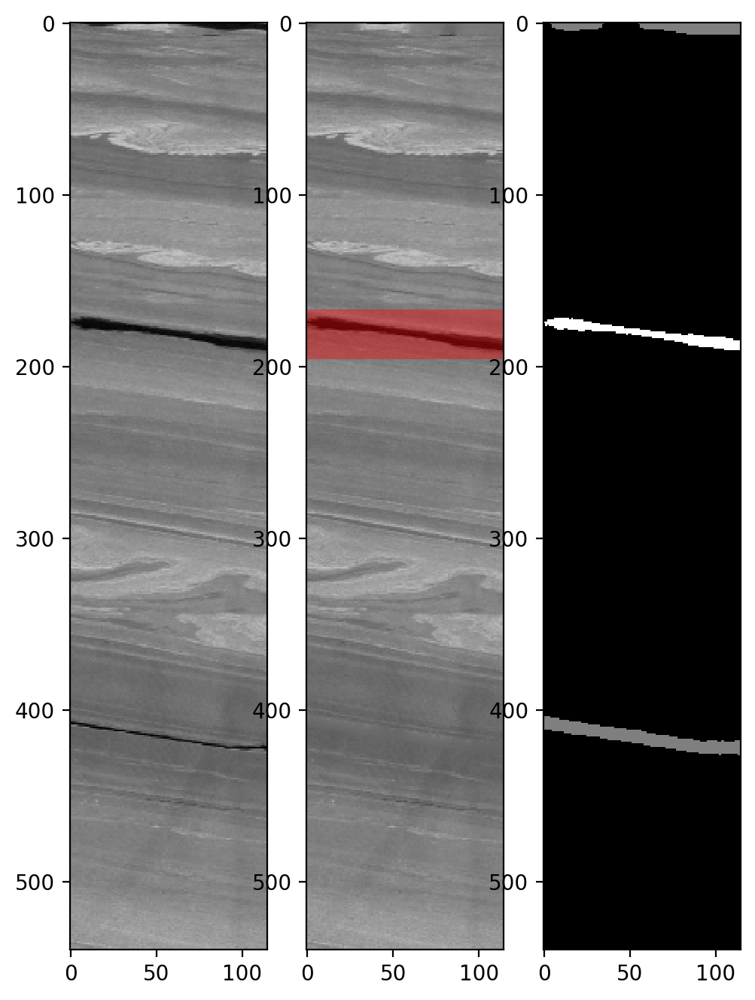

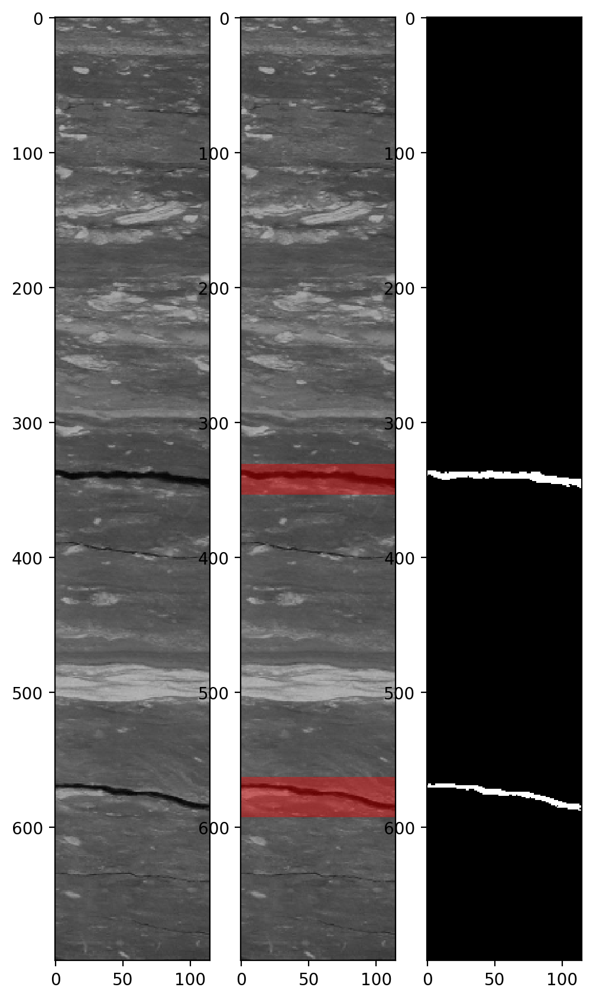

...

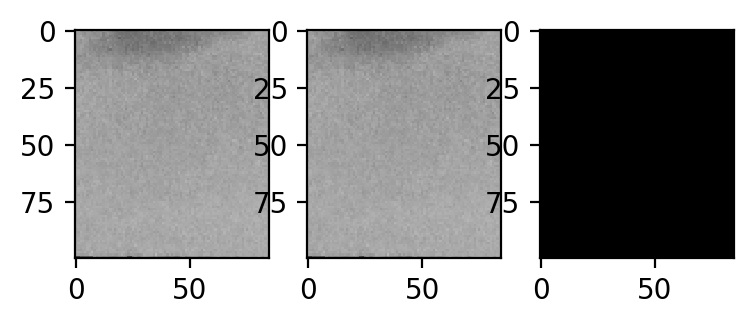

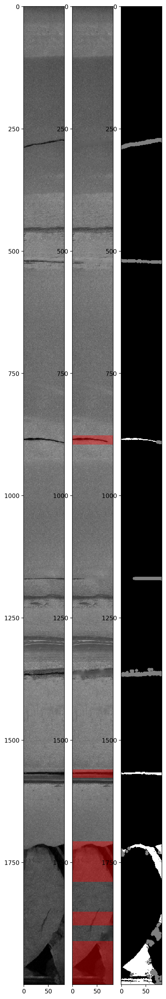

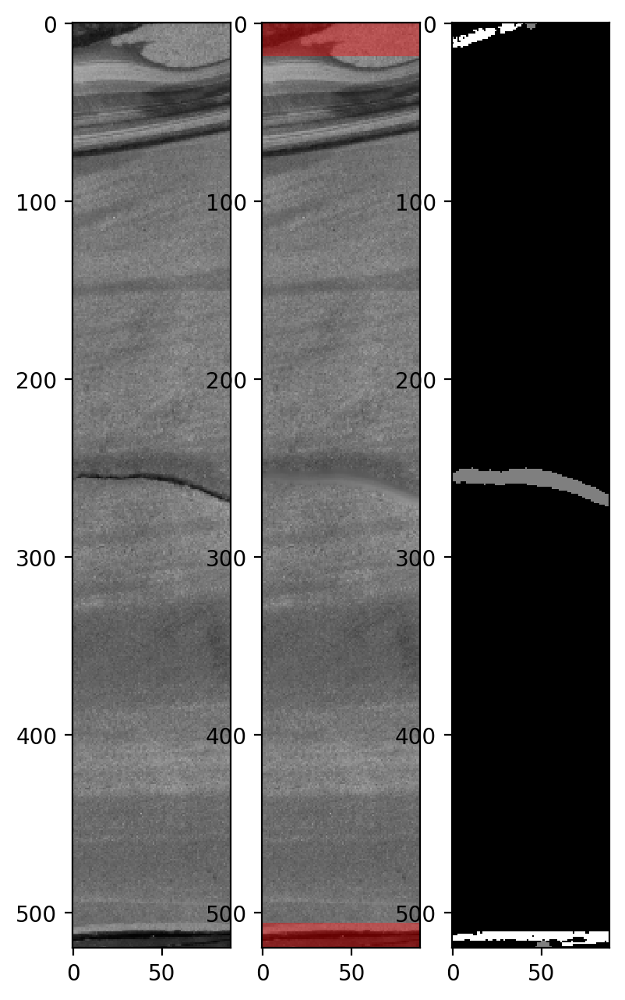

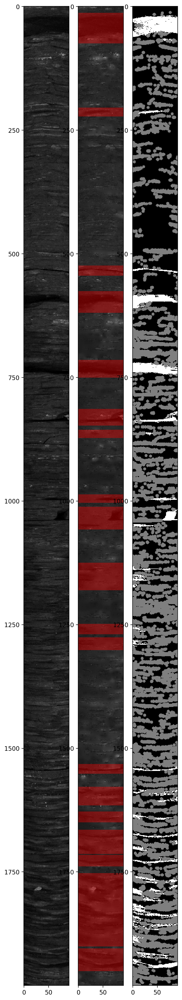

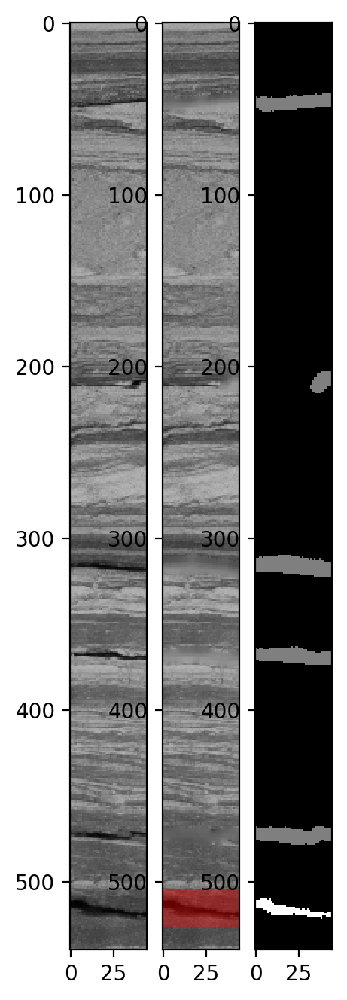

In [85]:
for index, row in df.iterrows():
    print(str(row["Id"])+" image")
    print("Ruin: "+str(row["Ruin"]))
    path = "{}/{}/data/{}.jpeg".format(WORK_DIR, row["Folder"],row["Id"])
    
    img = Image.open(path)
    print("Size: {}x{}".format(img.size[0], img.size[1]))
    
    absHeight = 100*(row["PhotoDown"]-row["PhotoTop"])
    print("Abs height: {} sm".format(absHeight))
    
    img = scaleImg(img, absH=absHeight, res=RESOLUTION)
    print("Scaled img size: {}x{}".format(img.size[0], img.size[1]))
    img = np.asarray(img)[:,:,0]

    img = cropBorders(img, res=RESOLUTION)
    mask = createCrackMask(img)
    
    bigCrackMask = createBigCrackMask(mask, crackSize=5)
    littleCrackMask = np.logical_and(mask, np.logical_not(bigCrackMask))
    littleCrackMask = nd.binary_dilation(littleCrackMask, structure=disk(3))
    
    crackZones = createBigCrackZones(bigCrackMask, radius=10)
    
    crackMask = np.copy(bigCrackMask)
    crackMask[littleCrackMask > 0] = 127
    
    imgWithoutCracks = removeLittleCracks(img, littleCrackMask, radius=5)
    
    maskRGB = Image.fromarray(crackMask)
    maskRGB = maskRGB.convert("RGB")
    
    before = Image.fromarray(img)
    before = before.convert("RGB")
    
    after = Image.fromarray(imgWithoutCracks)
    after = after.convert("RGB")
    after = selectZones(after, (255,0,0,100), crackZones)
    
    res = RESOLUTION
    fig,ax = plt.subplots(1, 3, figsize=(img.shape[1]/res, img.shape[0]/res), dpi=res*10)
    
    ax[0].imshow(before)
    ax[1].imshow(after)
    ax[2].imshow(maskRGB)
    
    
    print()